In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset

from torchvision import transforms

import numpy as np

import os
from PIL import Image


#### ---------- transform ----------

In [2]:
LEFT_IMG_KEY = 'left_img'
RIGHT_IMG_KEY = 'right_img'


def get_transforms(size=(256, 512), mode='train'):
    """Set transformations for training images."""
    if mode == 'train':
        transformations = transforms.Compose([
            ResizeImage(size=size, mode=mode),
            RandomFlip(mode=mode),
            ToTensor(mode=mode),
            AugmentSaturation(mode=mode),
        ])
    else:
        transformations = transforms.Compose([
            ResizeImage(size=size, mode=mode),
            ToTensor(mode=mode),
        ])
    return transformations


class RandomFlip(object):
    def __init__(self, mode='train'):
        self.transform = transforms.RandomHorizontalFlip(p=1)
        self.mode = mode

    def __call__(self, sample):
        if self.mode == 'train':
            k = np.random.uniform(0, 1, 1)
            if k > 0.5:
                left_image = sample[LEFT_IMG_KEY]
                right_image = sample[RIGHT_IMG_KEY]
                sample = {LEFT_IMG_KEY: self.transform(left_image),
                          RIGHT_IMG_KEY: self.transform(right_image)}
        return sample


class ToTensor(object):
    def __init__(self, mode='train'):
        self.transform = transforms.ToTensor()
        self.mode = mode

    def __call__(self, sample):
        if self.mode == 'train':
            left_img = sample[LEFT_IMG_KEY]
            right_img = sample[RIGHT_IMG_KEY]
            sample = {LEFT_IMG_KEY: self.transform(left_img),
                      RIGHT_IMG_KEY: self.transform(right_img)}
        else:
            sample = self.transform(sample)
        return sample


class ResizeImage(object):
    """Resize the ``sample`` pair to the given size."""
    def __init__(self, size=(256, 512), mode='train'):
        self.transform = transforms.Resize(size)
        self.mode = mode

    def __call__(self, sample):
        if self.mode == 'train':
            left_img = sample[LEFT_IMG_KEY]
            right_img = sample[RIGHT_IMG_KEY]
            sample = {LEFT_IMG_KEY: self.transform(left_img),
                      RIGHT_IMG_KEY: self.transform(right_img)}
        else:
            sample = self.transform(sample)
        return sample


class AugmentSaturation(object):
    """
    Augment the image with random saturation in given range. \n
    Default values are provided by the referenced paper.
    """
    def __init__(self, mode='train',
                 gamma_low=0.8, gamma_high=1.2,
                 brightness_low=0.5, brightness_high=2.0,
                 color_low=0.8, color_high=1.2):
        self.mode = mode
        self.gamma_low = gamma_low
        self.gamma_high = gamma_high
        self.brightness_low = brightness_low
        self.brightness_high = brightness_high
        self.color_low = color_low
        self.color_high = color_high

    def __call__(self, sample):
        left_img = sample[LEFT_IMG_KEY]
        right_img = sample[RIGHT_IMG_KEY]
        p = np.random.uniform(0, 1, 1)
        if self.mode == 'train':
            if p > 0.5:
                # randomly shift gamma
                random_gamma = np.random.uniform(self.gamma_low, self.gamma_high)
                left_image_aug = left_img ** random_gamma
                right_image_aug = right_img ** random_gamma

                # randomly shift brightness
                random_brightness = np.random.uniform(self.brightness_low, self.brightness_high)
                left_image_aug = left_image_aug * random_brightness
                right_image_aug = right_image_aug * random_brightness

                # randomly shift color
                random_colors = np.random.uniform(self.color_low, self.color_high, 3)
                for i in range(3):
                    left_image_aug[i, :, :] *= random_colors[i]
                    right_image_aug[i, :, :] *= random_colors[i]

                # saturate
                left_image_aug = torch.clamp(left_image_aug, 0, 1)
                right_image_aug = torch.clamp(right_image_aug, 0, 1)

                sample = {LEFT_IMG_KEY: left_image_aug, RIGHT_IMG_KEY: right_image_aug}
        return sample

#### ---------- data_loader ----------

In [3]:
# KITTI dataset defaults images from left and right view as followed
LEFT_FILE_NAME = 'image_2'
RIGHT_FILE_NAME = 'image_3'


class KittiDataSet(Dataset):
    """Kitti Dataset"""
    def __init__(self, root_dir_left: str, root_dir_right: str, mode, transform=None):
        left_dir = os.path.join(root_dir_left, LEFT_FILE_NAME)
        self.left_path = sorted([os.path.join(left_dir, file_name) for file_name in os.listdir(left_dir)])
        if mode == 'train':
            right_dir = os.path.join(root_dir_right, RIGHT_FILE_NAME)
            self.right_path = sorted([os.path.join(right_dir, file_name) for file_name in os.listdir(right_dir)])
            assert len(self.left_path) == len(self.right_path)
        self.transform = transform
        self.mode = mode

    def __len__(self):
        return len(self.left_path)

    def __getitem__(self, idx):
        left_img = self.load_img(self.left_path[idx])
        if self.mode == 'train':
            right_img = self.load_img(self.right_path[idx])
            sample = {'left_img': left_img, 'right_img': right_img}
            if self.transform:
                sample = self.transform(sample)
            return sample
        else:
            if self.transform:
                left_img = self.transform(left_img)
            return left_img

    def load_img(self, img_path):
        img = Image.open(img_path)
        return img

#### ---------- loss ----------

In [4]:
class MonoDepthLoss(nn.Module):
    def __init__(self, c_ap_alpha=0.85, smoothness_weight=1.0, lr_consistency_weight=1.0):
        """
        MonoDepth loss function
        :param c_ap_alpha: hyper parameter alpha for ``SSIM`` loss
        """""
        super(MonoDepthLoss, self).__init__()
        self.c_ap_alpha = c_ap_alpha
        self.smoothness_weight = smoothness_weight
        self.lr_consistency_weight = lr_consistency_weight

    def scale_pyramid(self, img, num_scales):
        """
        Get scaled images
        :param img: input image [b, 3, h, w]
        :param num_scales: number of level to scale
        :return: list of scaled images [b, 3, nh, nw]
        """""
        scaled_imgs = [img]
        h = img.size(2)
        w = img.size(3)
        for i in range(num_scales - 1):
            ratio = 2 ** (i + 1)
            nh = h // ratio
            nw = w // ratio
            scaled_imgs.append(nn.functional.interpolate(img, size=[nh, nw], mode='bilinear', align_corners=True))
        return scaled_imgs

    def get_reconstruction_loss(self):
        """
        Calculate reconstruction loss ``C_ap`` from referenced paper
        :return: None
        """""
        # L1
        l1_left = [torch.mean(torch.abs(self.left_est[i] - self.left_pyramids[i])) for i in range(4)]
        l1_right = [torch.mean(torch.abs(self.right_est[i] - self.right_pyramids[i])) for i in range(4)]
        # SSIM
        ssim_left = [torch.mean(self.SSIM(self.left_est[i], self.left_pyramids[i])) for i in range(4)]
        ssim_right = [torch.mean(self.SSIM(self.right_est[i], self.right_pyramids[i])) for i in range(4)]
        # Reconstruction loss for each opposite view
        image_loss_left = [self.c_ap_alpha * ssim_left[i] + (1 - self.c_ap_alpha) * l1_left[i] for i in range(4)]
        image_loss_right = [self.c_ap_alpha * ssim_right[i] + (1 - self.c_ap_alpha) * l1_right[i] for i in range(4)]
        image_loss = sum(image_loss_left + image_loss_right)
        return image_loss

    def transform_with_disparity(self, img, disp):
        """
        Apply disparity transform to image to generate counterpart's view
        :param img: individual left image [b, 3, h, w]
        :param disp: corresponding disparity map [b, 1, h, w]
        :return: 
        """""
        batch_size, _, height, width = img.size()
        # Create mesh grid
        x_base = torch.linspace(0, 1, width).repeat(batch_size, height, 1).type_as(img)
        y_base = torch.linspace(0, 1, height).repeat(batch_size, width, 1).transpose(1, 2).type_as(img)
        # Shirt in x direction
        x_shifts = disp[:, 0, :, :]
        # Prepare for interpolation and normalize to range [-1, 1]
        flow_field = torch.stack((x_base + x_shifts, y_base), dim=3)  # original range [0, 1] from linspace
        flow_field = flow_field * 2 - 1

        output = F.grid_sample(img, flow_field, mode='bilinear', align_corners=True, padding_mode='zeros')
        return output

    def generate_image_left(self, img, disp):
        """
        Generate left image from right ``img`` using ``disp``
        :param img: individual left image [b, 3, h, w]
        :param disp: corresponding disparity map [b, 1, h, w]
        :return: left image [b, 3, h, w]
        """""
        return self.transform_with_disparity(img, -disp)

    def generate_image_right(self, img, disp):
        """
        Generate right image from left ``img`` using disp``
        :param img: individual right image [b, 3, h, w]
        :param disp: corresponding disparity map [b, 1, h, w]
        :return: right image [b, 3, h, w]
        """""
        return self.transform_with_disparity(img, disp)

    def SSIM(self, x, y):
        """
        Compute SSIM loss
        :param x: true image [b, 3, h, w]
        :param y: reconstructed image [b, 3, h, w]
        :return: ``float``
        """""
        # Constants used in SSIM loss
        # More information here: https://en.wikipedia.org/wiki/Structural_similarity_index_measure
        C1 = 0.01 ** 2
        C2 = 0.03 ** 2

        mu_x = nn.AvgPool2d(3, 1)(x)
        mu_y = nn.AvgPool2d(3, 1)(y)
        mu_x_mu_y = mu_x * mu_y
        mu_x_sq = mu_x.pow(2)
        mu_y_sq = mu_y.pow(2)

        sigma_x = nn.AvgPool2d(3, 1)(x * x) - mu_x_sq
        sigma_y = nn.AvgPool2d(3, 1)(y * y) - mu_y_sq
        sigma_xy = nn.AvgPool2d(3, 1)(x * y) - mu_x_mu_y

        ssim_n = (2 * mu_x_mu_y + C1) * (2 * sigma_xy + C2)             # numerator
        ssim_d = (mu_x_sq + mu_y_sq + C1) * (sigma_x + sigma_y + C2)    # denominator
        ssim = ssim_n / ssim_d

        return torch.clamp((1 - ssim) / 2, 0, 1)  # (1 - SSIM) / 2 to prepare for C_ap

    def get_smoothness_loss(self):
        """
        Compute disparity smoothness loss ``C_ds`` from referenced paper
        :return: ``float``
        """""
        disp_left_smoothness = self.get_disparity_smoothness(self.left_est, self.left_pyramids)
        disp_right_smoothness = self.get_disparity_smoothness(self.right_est, self.right_pyramids)
        # Give less weights to lower scale by dividing by 2^scale_level
        disp_left_loss = [torch.mean(torch.abs(disp_left_smoothness[i])) / 2 ** i for i in range(4)]
        disp_right_loss = [torch.mean(torch.abs(disp_right_smoothness[i])) / 2 ** i for i in range(4)]
        return sum(disp_left_loss + disp_right_loss)

    def get_disparity_smoothness(self, disp, pyramid):
        """
        Get disparity smoothness, equation (3) from referenced paper
        :param disp: disparity map [b, 1, h, w] x 4 scale level
        :param pyramid: scaled images [batch, 3, h, w] x 4 scale level
        :return: 
        """""
        disp_gradients_x = [self.gradient_x(d) for d in disp]
        disp_gradients_y = [self.gradient_y(d) for d in disp]

        image_gradients_x = [self.gradient_x(img) for img in pyramid]
        image_gradients_y = [self.gradient_y(img) for img in pyramid]

        weights_x = [torch.exp(-torch.mean(torch.abs(g), 1, keepdim=True)) for g in image_gradients_x]
        weights_y = [torch.exp(-torch.mean(torch.abs(g), 1, keepdim=True)) for g in image_gradients_y]

        smoothness_x = [disp_gradients_x[i] * weights_x[i] for i in range(4)]
        smoothness_y = [disp_gradients_y[i] * weights_y[i] for i in range(4)]
        return smoothness_x + smoothness_y

    def gradient_x(self, img):
        """
        Calculate gradient in x direction
        :param img: image to calculate gradient [batch, channel, h, w]
        :return: gradient in x direction [batch, channel, h, w]
        """""
        img = F.pad(img, (0, 1, 0, 0), mode="replicate")
        gx = img[:, :, :, :-1] - img[:, :, :, 1:]
        return gx

    def gradient_y(self, img):
        """
        Calculate gradient in y direction
        :param img: image to calculate gradient [batch, channel, h, w]
        :return: gradient in x direction [batch, channel, h, w]
        """""
        img = F.pad(img, (0, 0, 0, 1), mode="replicate")
        gy = img[:, :, :-1, :] - img[:, :, 1:, :]
        return gy

    def get_lr_consistency_loss(self):
        """
        Compute disparity smoothness loss ``C_lr`` from referenced paper
        :return: ``float``
        """""
        right_to_left_disp = [self.generate_image_left(self.disp_right_est[i],
                                                       self.disp_left_est[i]) for i in range(4)]
        left_to_right_disp = [self.generate_image_right(self.disp_left_est[i],
                                                        self.disp_right_est[i]) for i in range(4)]

        lr_left_loss = [torch.mean(torch.abs(right_to_left_disp[i]
                                             - left_to_right_disp[i])) for i in range(4)]
        lr_right_loss = [torch.mean(torch.abs(left_to_right_disp[i]
                                              - right_to_left_disp[i])) for i in range(4)]
        lr_loss = sum(lr_left_loss + lr_right_loss)
        return lr_loss

    def _build_outputs(self, disparities, targets):
        """
        Prepare data for loss calculation
        :param disparities: disparity map [b, 1, h, w] x 4 scale level
        :param targets: [left_images, right_images] [b, 3, h, w]
        :return: ``None``
        """""
        left_images, right_images = targets
        left_pyramids = self.scale_pyramid(left_images, 4)
        right_pyramids = self.scale_pyramid(right_images, 4)
        disp_left_est = [d[:, 0, :, :].unsqueeze(1) for d in disparities]
        disp_right_est = [d[:, 1, :, :].unsqueeze(1) for d in disparities]

        self.disp_est = disparities                 # [batch, 2, h, w] x 4 scale level
        self.left_images = left_images              # [batch, 3, h, w]
        self.right_images = right_images            # [batch, 3, h, w]
        self.disp_left_est = disp_left_est          # [batch, h, w]
        self.disp_right_est = disp_right_est        # [batch, h, w]
        self.left_pyramids = left_pyramids          # [batch, 3, h, w] x 4 scale level
        self.right_pyramids = right_pyramids        # [batch, 3, h, w] x 4 scale level
        self.left_est = [self.generate_image_left(self.right_pyramids[i], self.disp_left_est[i]) for i in range(4)]
        # [batch, 3, h, w] x 4 scale level
        self.right_est = [self.generate_image_right(self.left_pyramids[i], self.disp_right_est[i]) for i in range(4)]
        # [batch, 3, h, w] x 4 scale level

    def forward(self, disparities, targets):
        """
        Feed forward function to compute loss for MonoDepth
        :param disparities: disparity outputs from 4 scales [b, 1, h, w]
        :param targets: [left_images, right_images] [b, 3, h, w]
        :return: ``float``
        """""
        self._build_outputs(disparities, targets)

        reconstruction_loss = self.get_reconstruction_loss()
        smoothness_loss = self.get_smoothness_loss()
        lr_consistency_loss = self.get_lr_consistency_loss()

        total_loss = (reconstruction_loss + smoothness_loss * self.smoothness_weight +
                      lr_consistency_loss * self.lr_consistency_weight)
        return total_loss

#### ---------- models ----------

In [5]:
class SimpleAutoEncoderMD(nn.Module):
    def __init__(self, size=(256, 512), resnet=None):
        super(SimpleAutoEncoderMD, self).__init__()
        self.size = size

        if not resnet:
            self.encoder = Encoder(resnet=resnet)
            self.decoder = Decoder(resnet=resnet)

    def forward(self, x):
        x = self.encoder(x)
        disp = self.decoder(x)
        return disp


class Encoder(nn.Module):
    def __init__(self, resnet=None):
        super(Encoder, self).__init__()

        if not resnet:
            # Input shape: [8, 3, 256, 512] == [batch, channel, height, width]
            c_in = 3            # [3  , 256, 512]
            c1_encoder = 64     # [64 , 128, 256]
            c2_encoder = 128    # [128,  64, 128]
            c3_encoder = 256    # [256,  32,  64]
            c_out = 512         # [512,  16,  32]
            self.encoder = nn.Sequential(
                nn.Conv2d(c_in, c1_encoder, kernel_size=3, stride=2, padding=1),
                nn.ELU(),
                nn.Conv2d(c1_encoder, c2_encoder, kernel_size=3, stride=2, padding=1),
                nn.ELU(),
                nn.Conv2d(c2_encoder, c3_encoder, kernel_size=3, stride=2, padding=1),
                nn.ELU(),
                nn.Conv2d(c3_encoder, c_out, kernel_size=3, stride=2, padding=1),
            )

    def forward(self, x):
        return self.encoder(x)


class Decoder(nn.Module):
    def __init__(self, resnet=None):
        super(Decoder, self).__init__()
        self.resnet = resnet
        if not resnet:
            self.c_in = 512          # [512,  16,  32]
            self.c1_decoder = 256    # [256,  32,  64] -> disp4
            self.c2_decoder = 128    # [128,  64, 128] -> disp3
            self.c3_decoder = 256    # [64 , 128, 256] -> disp2
            self.c_out = 32          # [32 , 256, 512] -> disp1
            self.upConv1 = nn.ConvTranspose2d(self.c_in, self.c1_decoder, kernel_size=4, stride=2, padding=1)
            self.upConv2 = nn.ConvTranspose2d(self.c1_decoder, self.c2_decoder, kernel_size=4, stride=2, padding=1)
            self.upConv3 = nn.ConvTranspose2d(self.c2_decoder, self.c3_decoder, kernel_size=4, stride=2, padding=1)
            self.upConv4 = nn.ConvTranspose2d(self.c3_decoder, self.c_out, kernel_size=4, stride=2, padding=1)
            self.ELU = nn.ELU()

    def forward(self, x):
        if not self.resnet:
            x = self.upConv1(x)
            x = self.ELU(x)
            disp4 = GetDisp(self.c1_decoder)(x)
            x = self.upConv2(x)
            x = self.ELU(x)
            disp3 = GetDisp(self.c2_decoder)(x)
            x = self.upConv3(x)
            x = self.ELU(x)
            disp2 = GetDisp(self.c3_decoder)(x)
            x = self.upConv4(x)
            x = self.ELU(x)
            disp1 = GetDisp(self.c_out)(x)

            return disp1, disp2, disp3, disp4


class GetDisp(nn.Module):
    def __init__(self, num_input_layers):
        """
        Class to get disparity map at different scale. Referenced from 3.2. Depth Estimation Network
        :param num_input_layers: number of layers of the current deconvolution layer
        """""
        super(GetDisp, self).__init__()
        self.conv = nn.Conv2d(num_input_layers, 2, kernel_size=3, stride=1)
        self.normalize = nn.BatchNorm2d(2)
        self.activate = torch.nn.Sigmoid()

    def forward(self, x):
        p = 1
        padding = (p, p, p, p)
        x = self.conv(F.pad(x, padding))
        x = self.normalize(x)
        return 0.3 * self.activate(x)


class Conv(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride):
        super(Conv, self).__init__()
        self.kernel_size = kernel_size
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=stride)
        self.normalize = nn.BatchNorm2d(out_channels)

    def forward(self, x):
        p = int(np.floor((self.kernel_size - 1) / 2))
        padding = (p, p, p, p)
        x = self.conv(F.pad(x, padding))
        x = self.normalize(x)
        return F.elu(x, inplace=True)


class UpConv(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, scale=2):
        super(UpConv, self).__init__()
        self.scale = scale
        self.conv = Conv(in_channels, out_channels, kernel_size=kernel_size, stride=1)

    def forward(self, x):
        x = nn.functional.interpolate(x, scale_factor=self.scale, mode='bilinear', align_corners=True)
        return self.conv(x)


class MaxPool(nn.Module):
    def __init__(self, kernel_size):
        super(MaxPool, self).__init__()
        self.kernel_size = kernel_size

    def forward(self, x):
        p = int(np.floor((self.kernel_size - 1) / 2))
        padding = (p, p, p, p)
        x = F.pad(x, padding)
        x = F.max_pool2d(x, kernel_size=self.kernel_size, stride=2)
        return x


class ResConv(nn.Module):
    def __init__(self, in_channels, out_channels, stride):
        super(ResConv, self).__init__()
        self.out_channels = out_channels
        self.stride = stride
        self.conv1 = Conv(in_channels, out_channels, kernel_size=1, stride=1)
        self.conv2 = Conv(out_channels, out_channels, kernel_size=3, stride=stride)
        self.conv3 = nn.Conv2d(out_channels, 4*out_channels, kernel_size=1, stride=1)
        self.conv4 = nn.Conv2d(in_channels, 4*out_channels, kernel_size=1, stride=stride)
        self.normalize = nn.BatchNorm2d(4*out_channels)

    def forward(self, x):
        x_out = self.conv1(x)
        x_out = self.conv2(x_out)
        x_out = self.conv3(x_out)
        shortcut = self.conv4(x)
        return F.elu(self.normalize(x_out + shortcut), inplace=True)


def res_block(in_channels, out_channels, num_blocks, stride):
    layers = list()
    layers.append(ResConv(in_channels, out_channels, stride=stride))
    for _ in range(1, num_blocks - 1):
        layers.append(ResConv(4 * out_channels, out_channels, 1))
    layers.append(ResConv(4 * out_channels, out_channels, 1))
    return nn.Sequential(*layers)


class Resnet50MonoDepth(nn.Module):
    def __init__(self, in_channels):
        super(Resnet50MonoDepth, self).__init__()
        # Encoder
        self.conv1 = Conv(in_channels, 64, kernel_size=7, stride=2)
        self.pool1 = MaxPool(kernel_size=3)
        self.conv2 = res_block(64, 64, 3, stride=2)
        self.conv3 = res_block(256, 128, 4, stride=2)
        self.conv4 = res_block(512, 256, 6, stride=2)
        self.conv5 = res_block(1024, 512, 3, stride=2)
        # Decoder
        self.upconv6 = UpConv(2048, 512, 3, 2)
        self.iconv6 = Conv(1024 + 512, 512, 3, 1)

        self.upconv5 = UpConv(512, 256, 3, 2)
        self.iconv5 = Conv(512 + 256, 256, 3, 1)

        self.upconv4 = UpConv(256, 128, 3, 2)
        self.iconv4 = Conv(256 + 128, 128, 3, 1)
        self.disp4_layer = GetDisp(128)

        self.upconv3 = UpConv(128, 64, 3, 2)
        self.iconv3 = Conv(64 + 64 + 2, 64, 3, 1)
        self.disp3_layer = GetDisp(64)

        self.upconv2 = UpConv(64, 32, 3, 2)
        self.iconv2 = Conv(32 + 64 + 2, 32, 3, 1)
        self.disp2_layer = GetDisp(32)

        self.upconv1 = UpConv(32, 16, 3, 2)
        self.iconv1 = Conv(16 + 2, 16, 3, 1)
        self.disp1_layer = GetDisp(16)

        self._initialize_weights()

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.xavier_uniform_(m.weight)

    def forward(self, x):
        # encoder
        x1 = self.conv1(x)
        x_pool1 = self.pool1(x1)
        x2 = self.conv2(x_pool1)
        x3 = self.conv3(x2)
        x4 = self.conv4(x3)
        x5 = self.conv5(x4)

        # skips
        skip1 = x1
        skip2 = x_pool1
        skip3 = x2
        skip4 = x3
        skip5 = x4

        # decoder
        upconv6 = self.upconv6(x5)
        concat6 = torch.cat((upconv6, skip5), 1)
        iconv6 = self.iconv6(concat6)

        upconv5 = self.upconv5(iconv6)
        concat5 = torch.cat((upconv5, skip4), 1)
        iconv5 = self.iconv5(concat5)

        upconv4 = self.upconv4(iconv5)
        concat4 = torch.cat((upconv4, skip3), 1)
        iconv4 = self.iconv4(concat4)
        disp4 = self.disp4_layer(iconv4)
        udisp4 = nn.functional.interpolate(disp4, scale_factor=2, mode='bilinear', align_corners=True)

        upconv3 = self.upconv3(iconv4)
        concat3 = torch.cat((upconv3, skip2, udisp4), 1)
        iconv3 = self.iconv3(concat3)
        disp3 = self.disp3_layer(iconv3)
        udisp3 = nn.functional.interpolate(disp3, scale_factor=2, mode='bilinear', align_corners=True)

        upconv2 = self.upconv2(iconv3)
        concat2 = torch.cat((upconv2, skip1, udisp3), 1)
        iconv2 = self.iconv2(concat2)
        disp2 = self.disp2_layer(iconv2)
        udisp2 = nn.functional.interpolate(disp2, scale_factor=2, mode='bilinear', align_corners=True)

        upconv1 = self.upconv1(iconv2)
        concat1 = torch.cat((upconv1, udisp2), 1)
        iconv1 = self.iconv1(concat1)
        disp1 = self.disp1_layer(iconv1)

        return disp1, disp2, disp3, disp4

#### ---------- utils ----------

In [6]:
import collections
from matplotlib import pyplot as plt


In [7]:
def to_device(input, device):
    if torch.is_tensor(input):
        return input.to(device=device)
    elif isinstance(input, str):
        return input
    elif isinstance(input, collections.abc.Mapping):
        return {k: to_device(sample, device=device) for k, sample in input.items()}
    elif isinstance(input, collections.Sequence):
        return [to_device(sample, device=device) for sample in input]
    else:
        raise TypeError(f"Input must contain tensor, dict or list, found {type(input)}")


def adjust_learning_rate(optimizer, epoch, learning_rate):
    """Sets the learning rate to the initial LR\
        decayed by 2 every 10 epochs after 30 epoches"""

    if 30 <= epoch < 40:
        lr = learning_rate / 2
    elif epoch >= 40:
        lr = learning_rate / 4
    else:
        lr = learning_rate
    for param_group in optimizer.param_groups:
        param_group['lr'] = lr


def save_output_numpy(output: np.ndarray, dir_path='./model_output/numpy', filename='output.npy'):
    ensure_dir_path(dir_path)
    save_filepath = os.path.join(dir_path, filename)
    np.save(save_filepath, output)


def read_output_numpy(dir_path='./model_output/numpy', filename='output.npy') -> np.ndarray:
    ensure_dir_path(dir_path)
    output = np.load(os.path.join(dir_path, filename))
    return output


def save_output_image(output: np.ndarray, dir_path='./model_output/images', filename='output.jpg') -> None:
    ensure_dir_path(dir_path)
    output_filepath = os.path.join(dir_path, filename)
    plt.imshow(output)
    plt.imsave(output_filepath, output)
    
    
def save_output_images(epoch: int, left: torch.Tensor, disp: torch.Tensor,
                       dir_path='./model_output/images'):
    for index, (left_single, disp_single) in enumerate(zip(left, disp)):
        left_single = left_single.cpu().detach().numpy().astype(np.float32).transpose((1, 2, 0))
        disp_single = disp_single.cpu().detach().numpy().astype(np.float32)
        save_output_image(left_single, filename=f'input_{epoch}_{index}.jpg')
        save_output_image(disp_single, filename=f'output_{epoch}_{index}.jpg')
        

def save_model(model: torch.nn.Module, model_id: str, dir_path='./trained_models') -> None:
    print("Saving model...")
    ensure_dir_path(dir_path)
    save_filepath = os.path.join(dir_path, model_id + '.pt')
    torch.save(model.state_dict(), save_filepath)
    print("Model saved!")


def load_model(model_id: str, dir_path='./trained_models') -> torch.nn.Module:
    print("Loading model...")
    ensure_dir_path(dir_path)
    save_filepath = os.path.join(dir_path, model_id + '.pt')
    print("Model loaded!")
    return torch.load(save_filepath)


def ensure_dir_path(dir_path: str):
    if not os.path.exists(dir_path):
        os.mkdir(dir_path)

In [8]:
if not os.path.exists('./model_output'):
    os.mkdir('./model_output')

#### ---------- monodepth_main ----------

In [9]:
torch.cuda.is_available()

True

In [10]:
LEFT_IMG_KEY = 'left_img'
RIGHT_IMG_KEY = 'right_img'


class MonoDepthModel:
    def __init__(self,
                 model,
                 model_id,
                 train_dir_left='../../data/kitti/data_object_image_2/training',
                 train_dir_right='../../data/kitti/data_object_image_3/training',
                 test_dir_left='../../data/kitti/data_object_image_2/testing',
                 test_dir_right='../../data/kitti/data_object_image_2/testing',
                 output_dir_path='../../output',
                 mode='train',
                 test=False,
                 lr=1e-4,
                 control_lr=True,
                 batch_size=8,
                 max_epochs=10):
        """
        Initialize the MonoDepth model.
        """""
        self.train_dir_left = train_dir_left
        self.train_dir_right = train_dir_right
        self.test_dir_left = test_dir_left
        self.test_dir_right = test_dir_right
        self.output_dir_path = output_dir_path
        self.mode = mode
        self.test = test
        self.lr = lr
        self.control_lr = control_lr
        self.batch_size = batch_size
        self.max_epochs = max_epochs

        self.model = model
        self.model_id = model_id
        self.criterion = MonoDepthLoss()
        self.optimizer = torch.optim.Adam(self.model.parameters(), lr=self.lr)
        self.train_transforms = get_transforms(mode=mode)
        self.kitti_train_dataset = KittiDataSet(self.train_dir_left, self.train_dir_right, self.mode, self.train_transforms)
        self.kitti_train_dataloader = DataLoader(self.kitti_train_dataset, batch_size=self.batch_size, shuffle=True)
        self.test_transforms = get_transforms(mode='test ')
        self.kitti_test_dataset = KittiDataSet(self.test_dir_left, self.test_dir_right, 'test', self.test_transforms)
        self.kitti_test_dataloader = DataLoader(self.kitti_test_dataset, batch_size=self.batch_size, shuffle=True)

        if self.test:
            train_dir_left = test_dir_left
            train_dir_right = test_dir_right
            mode = 'test'
            self.kitti_test_dataset = KittiDataSet(train_dir_left, train_dir_right, mode)

        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'
        self.model.to(self.device)

    def train(self):
        if self.mode != 'train':
            print("Incorrect mode!")
            print("Set mode to 'train' to train the model")
            exit()
        print('-----------------')
        print('Start training...')
        for epoch in range(self.max_epochs):
            train_loss = 0.0
            if self.control_lr:
                adjust_learning_rate(self.optimizer, epoch, self.lr)
            disp = None
            left = None
            for data in self.kitti_train_dataloader:
                # Reset gradient
                self.optimizer.zero_grad()
                data = to_device(data, self.device)
                left = data[LEFT_IMG_KEY]
                right = data[RIGHT_IMG_KEY]
                disp = self.model(left)
                loss = self.criterion(disp, (left, right))
                loss.backward()
                self.optimizer.step()

                train_loss += loss.item()

            if epoch % 1 == 0:
                print(f'Epoch: {epoch} Train Loss: {train_loss:.4f}')

            if 1:  # show output
                show_left = left[0]
                show_left = show_left.cpu().detach().numpy().astype(np.float32).transpose((1, 2, 0))
                plt.imshow(show_left)
                plt.show()
                output = disp[0][0, 0, :, :]
                output = output.cpu().detach().numpy().astype(np.float32)
                plt.imshow(output)
                plt.show()
            
            if 0:  # save outputs
                amount = 5
                input_images = iter(self.kitti_test_dataloader)
                input_images = next(input_images)
                input_images = to_device(input_images, self.device)
                output_images = self.model(input_images)[0][:amount, 0, :, :]
                save_output_images(epoch, input_images, output_images)

        save_model(self.model, self.model_id)


-----------------
Start training...
Epoch: 0 Train Loss: 2647.9610


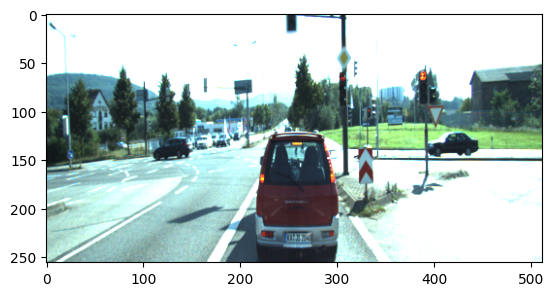

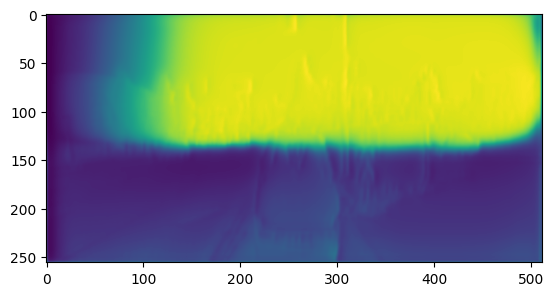

Epoch: 1 Train Loss: 2237.0733


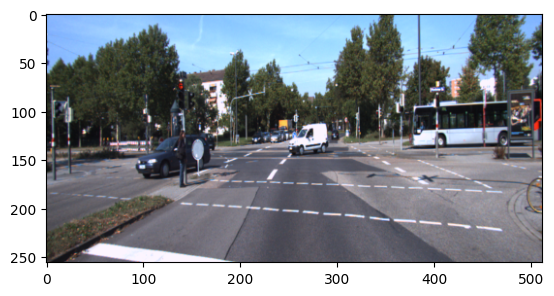

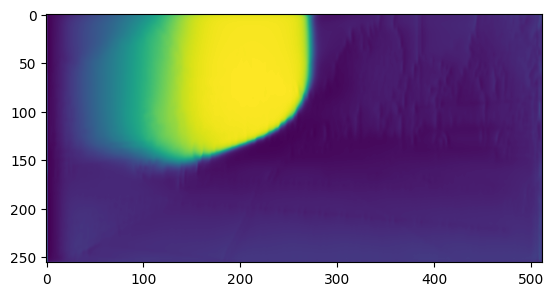

Epoch: 2 Train Loss: 1947.8615


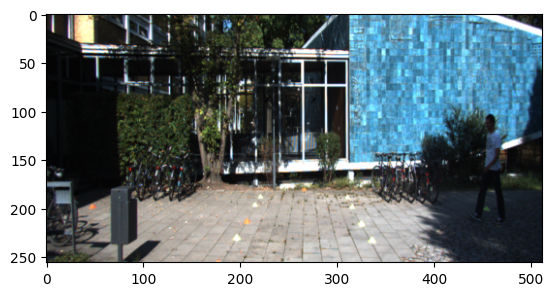

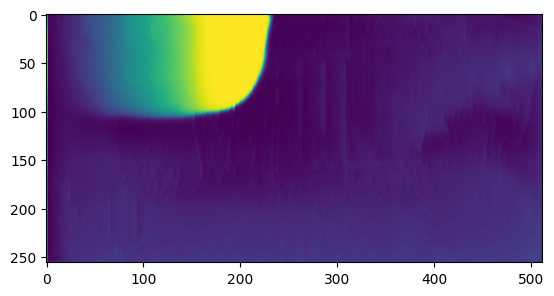

Epoch: 3 Train Loss: 1792.7039


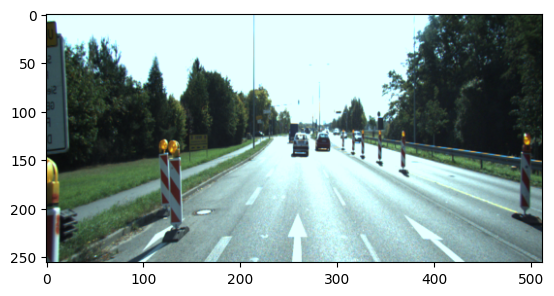

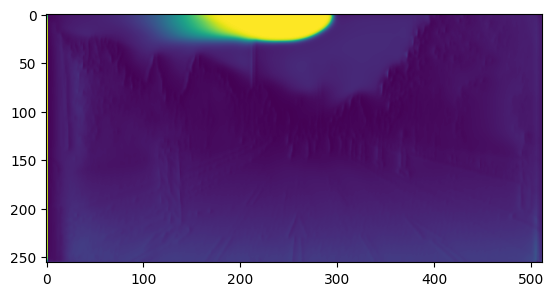

Epoch: 4 Train Loss: 1718.0619


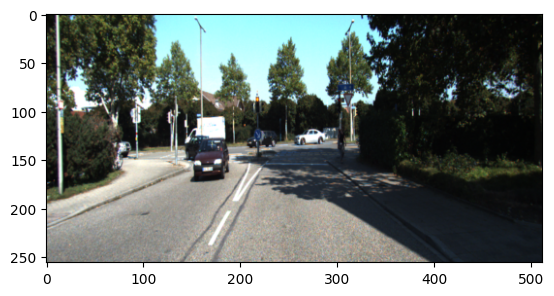

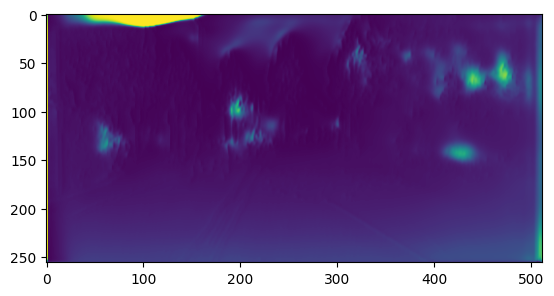

Epoch: 5 Train Loss: 1692.4813


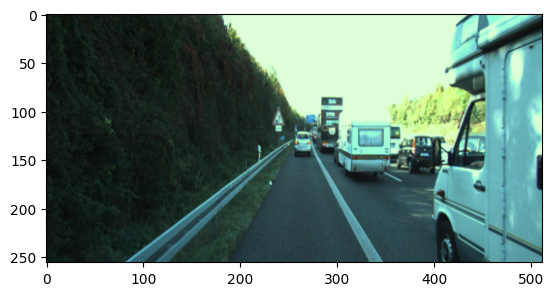

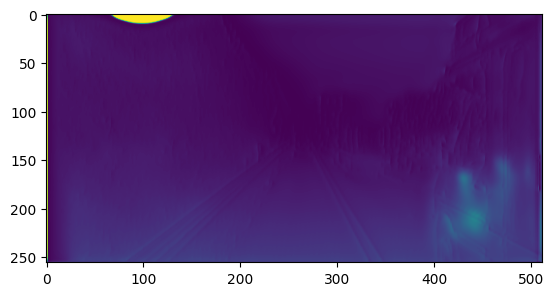

Epoch: 6 Train Loss: 1658.7503


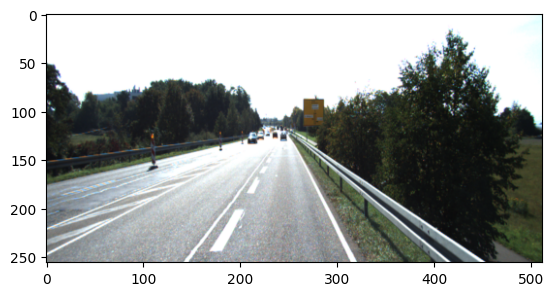

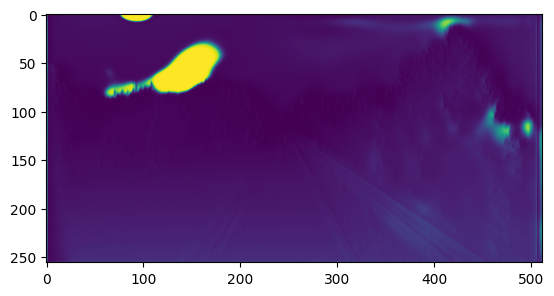

Epoch: 7 Train Loss: 1649.9379


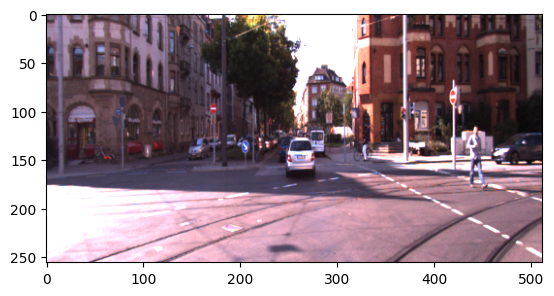

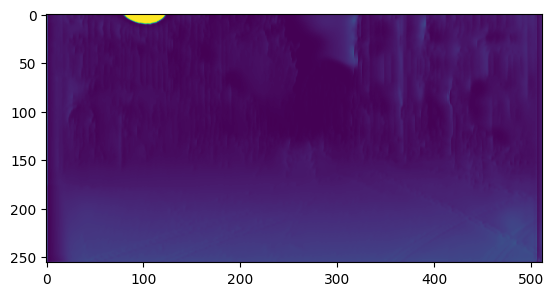

Epoch: 8 Train Loss: 1632.6334


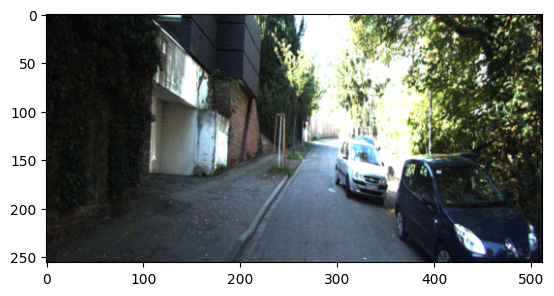

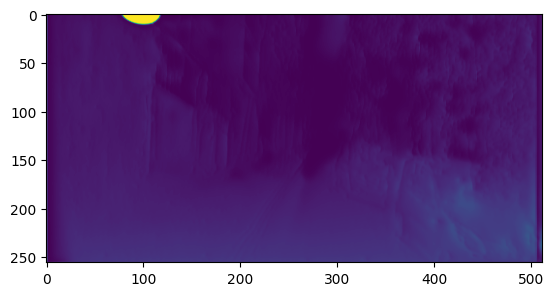

Epoch: 9 Train Loss: 1615.5709


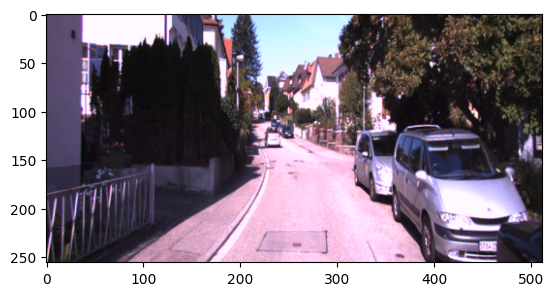

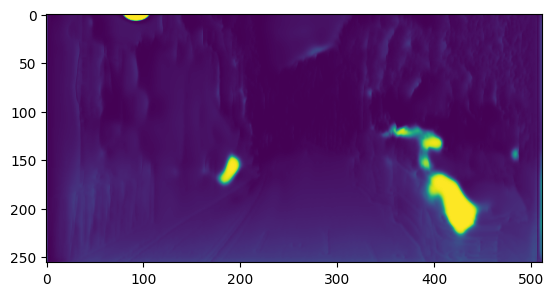

Epoch: 10 Train Loss: 1597.9128


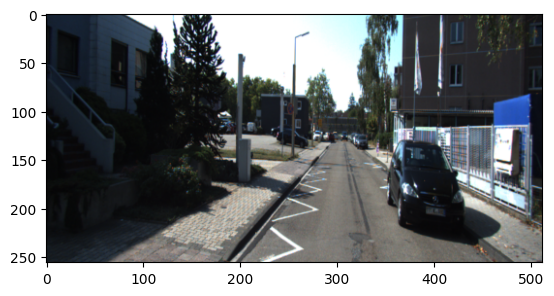

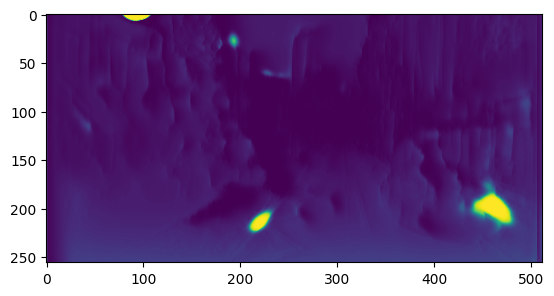

Epoch: 11 Train Loss: 1581.2646


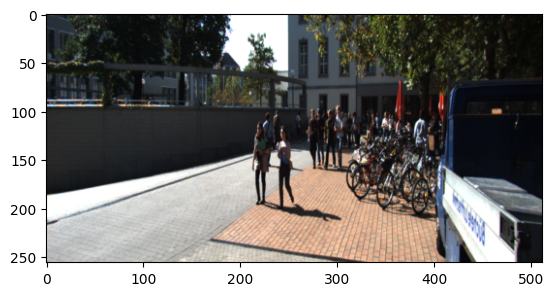

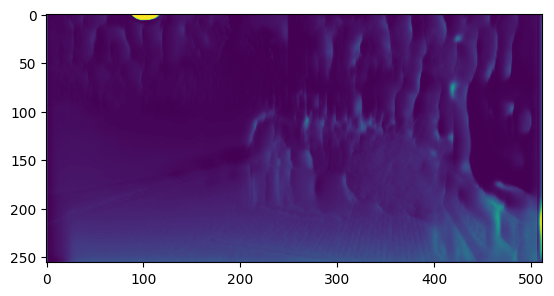

Epoch: 12 Train Loss: 1565.9874


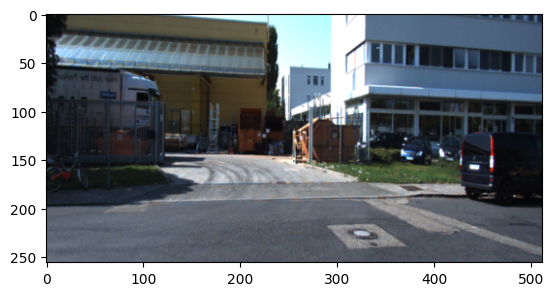

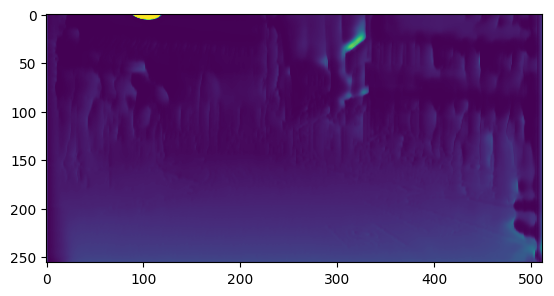

Epoch: 13 Train Loss: 1562.7032


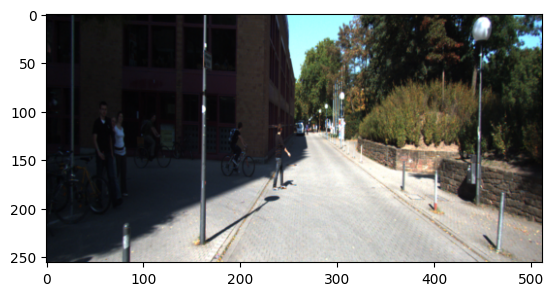

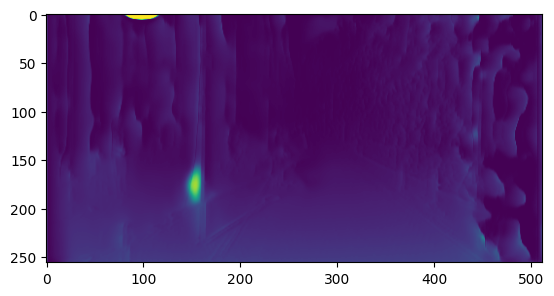

Epoch: 14 Train Loss: 1548.8754


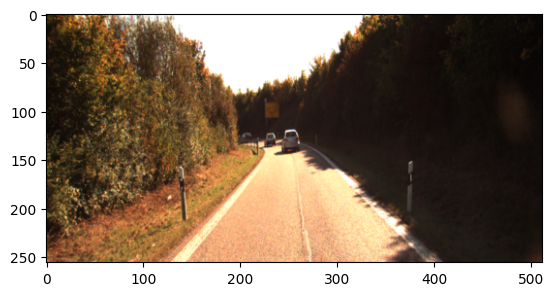

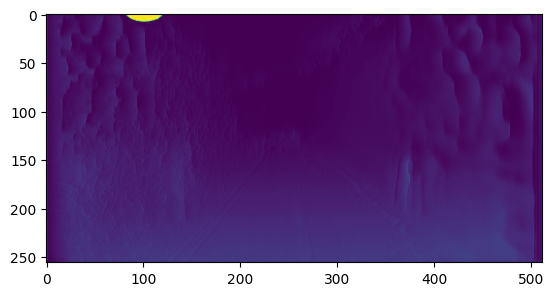

Epoch: 15 Train Loss: 1539.0585


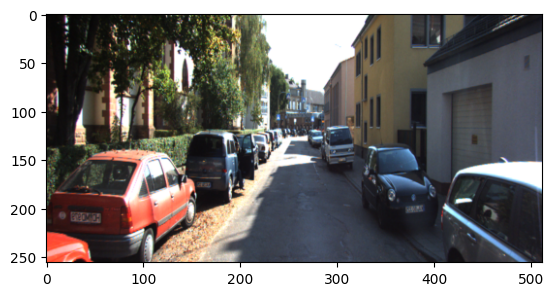

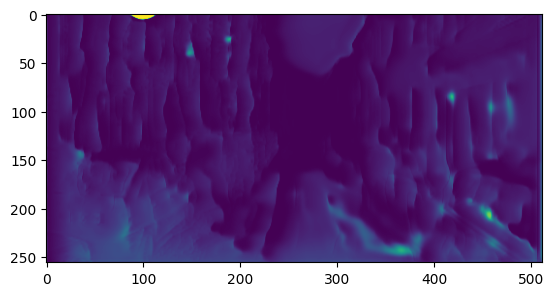

Epoch: 16 Train Loss: 1528.6236


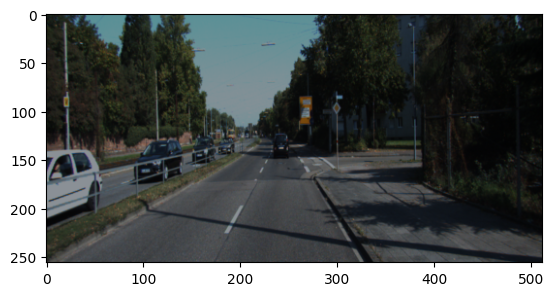

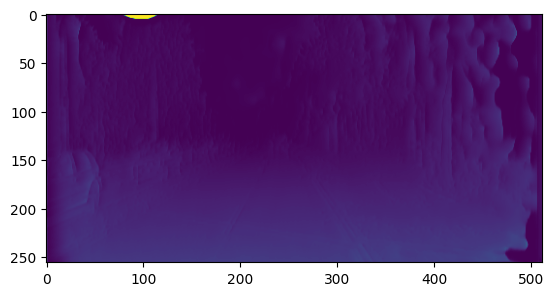

Epoch: 17 Train Loss: 1521.9687


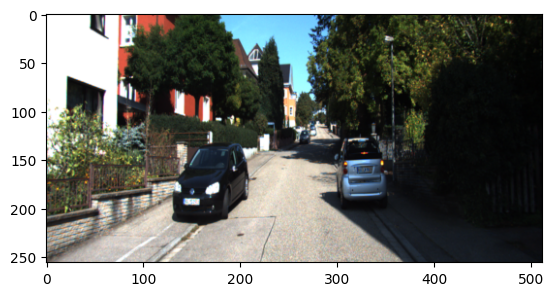

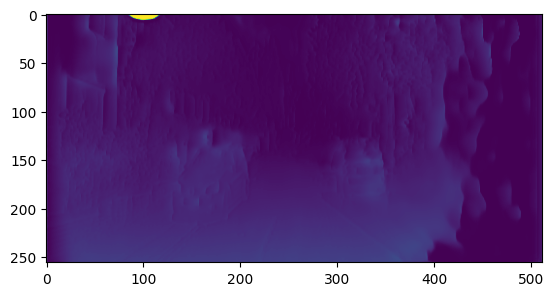

Epoch: 18 Train Loss: 1513.3589


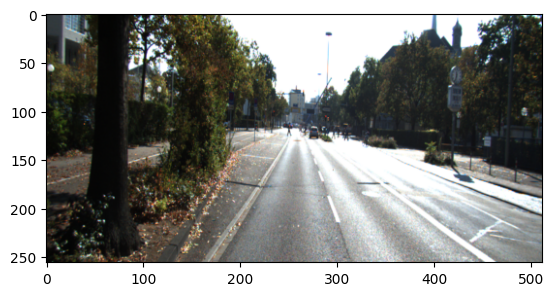

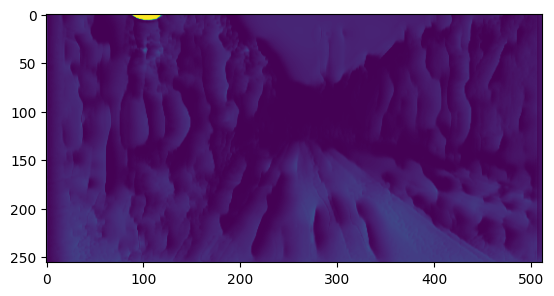

Epoch: 19 Train Loss: 1503.2678


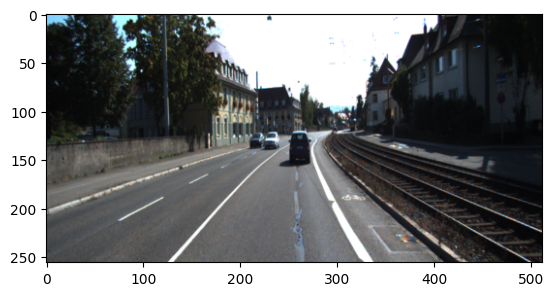

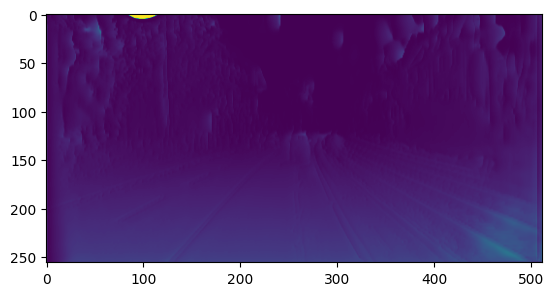

Epoch: 20 Train Loss: 1498.2684


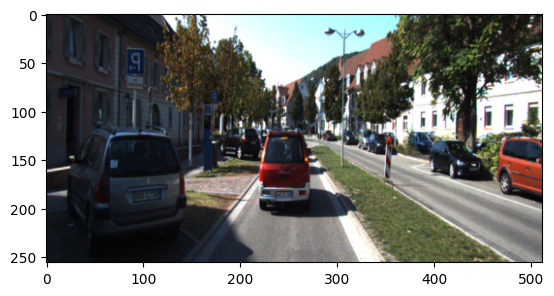

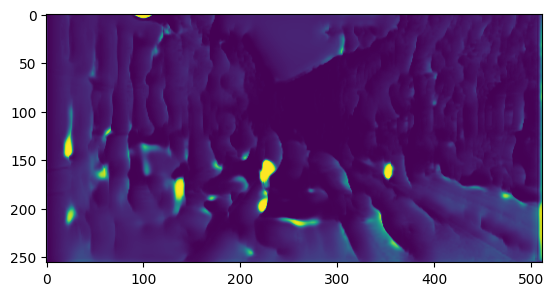

Epoch: 21 Train Loss: 1499.0755


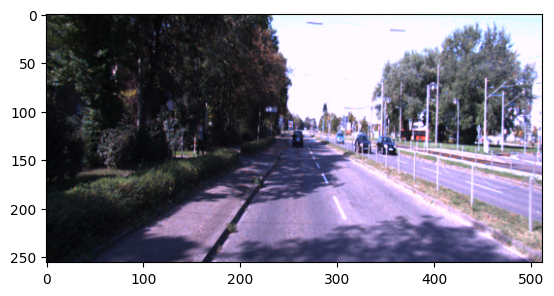

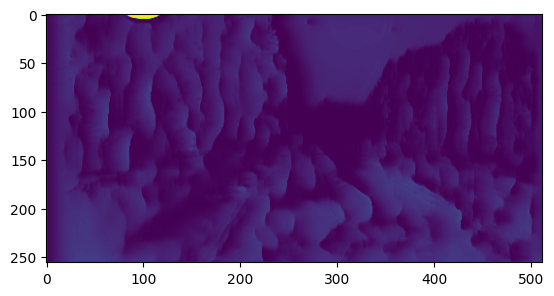

Epoch: 22 Train Loss: 1492.8789


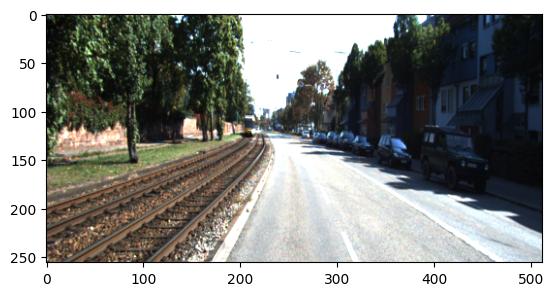

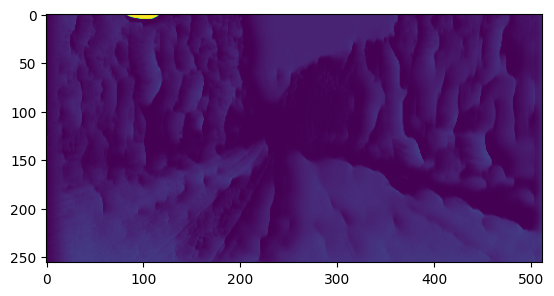

Epoch: 23 Train Loss: 1486.0605


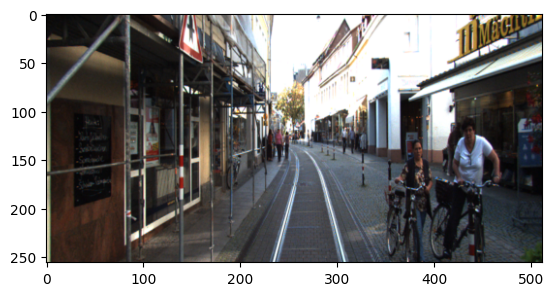

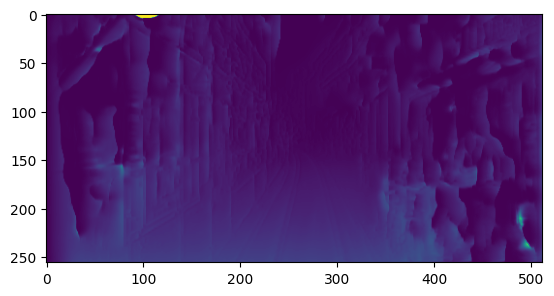

Epoch: 24 Train Loss: 1477.2840


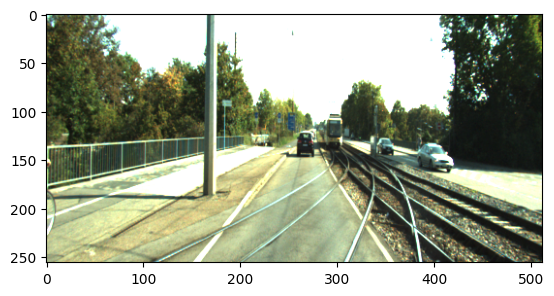

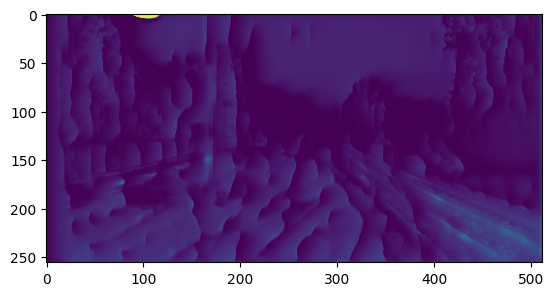

Epoch: 25 Train Loss: 1467.0116


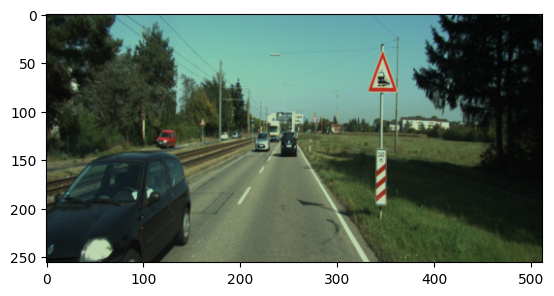

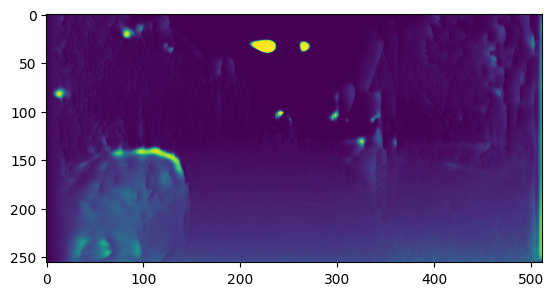

Epoch: 26 Train Loss: 1466.9842


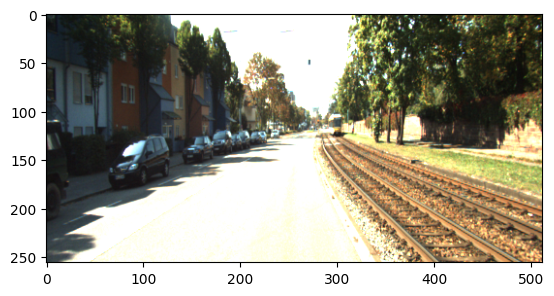

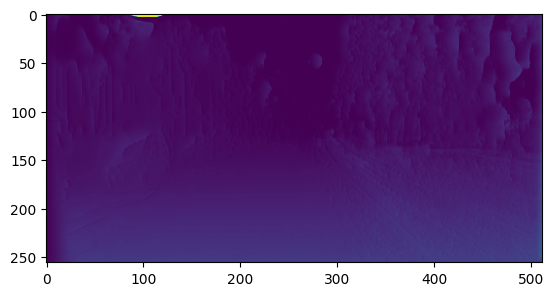

Epoch: 27 Train Loss: 1464.3541


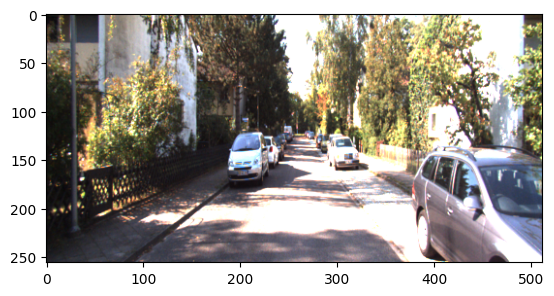

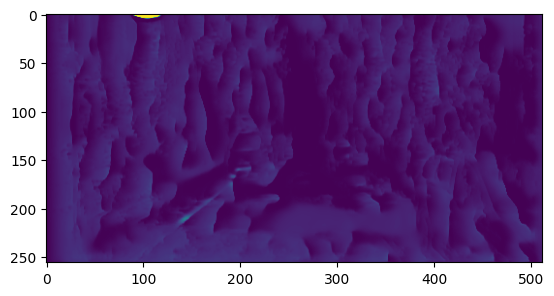

Epoch: 28 Train Loss: 1465.5130


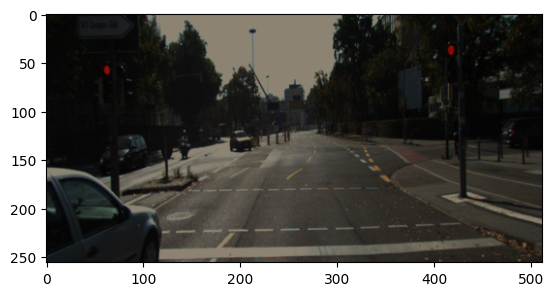

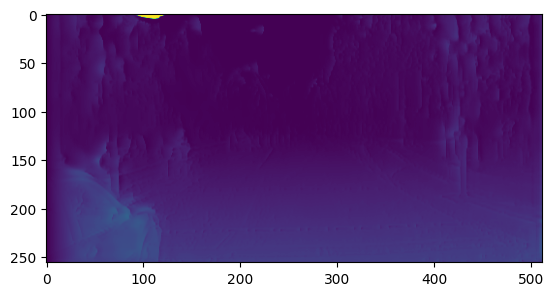

Epoch: 29 Train Loss: 1453.2465


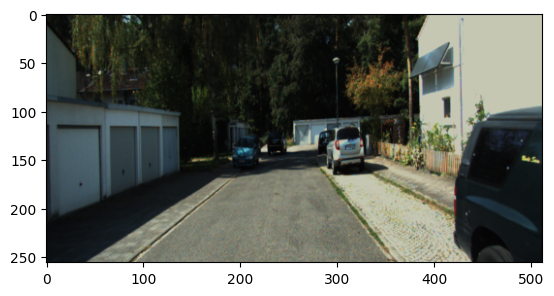

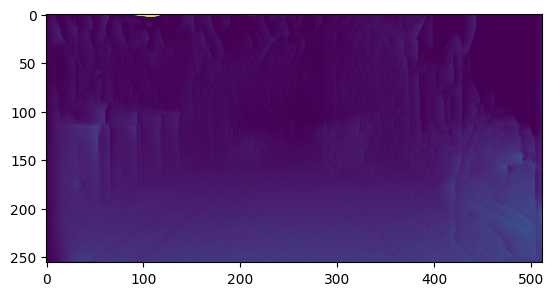

Epoch: 30 Train Loss: 1429.5754


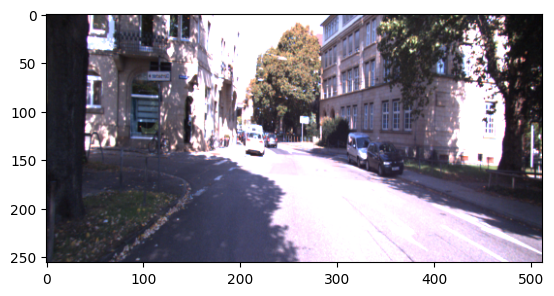

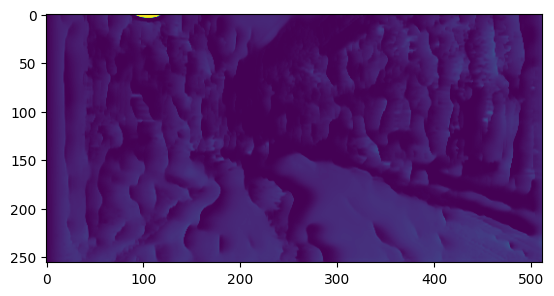

Epoch: 31 Train Loss: 1421.2011


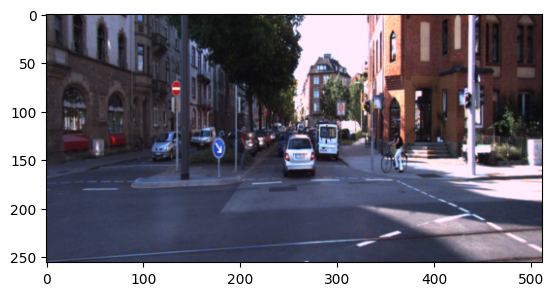

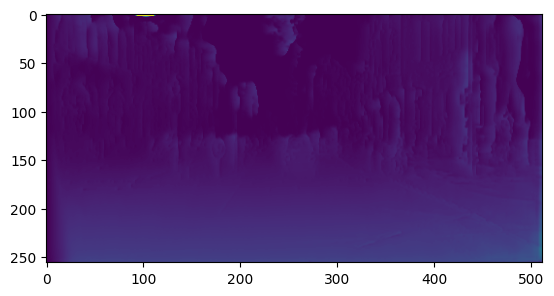

Epoch: 32 Train Loss: 1421.1003


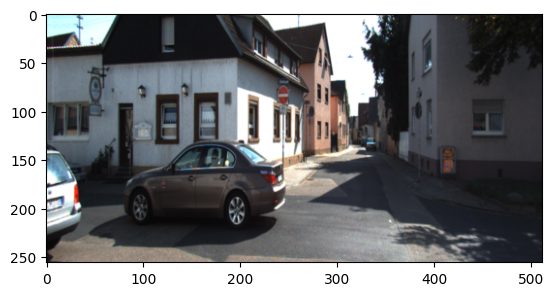

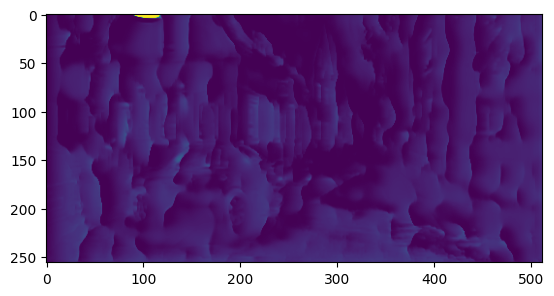

Epoch: 33 Train Loss: 1421.4138


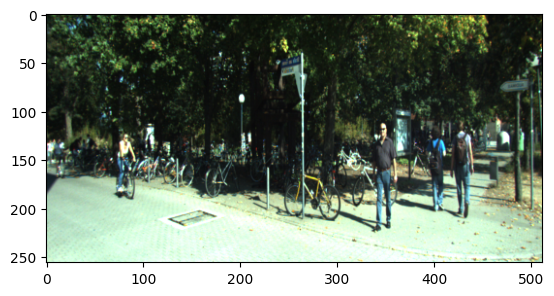

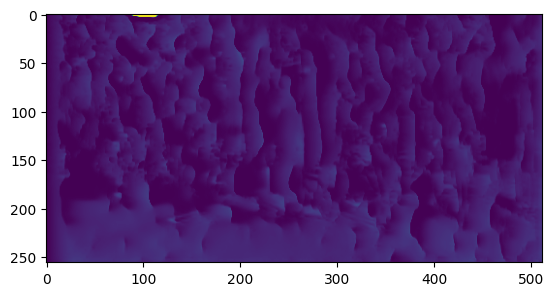

Epoch: 34 Train Loss: 1418.2080


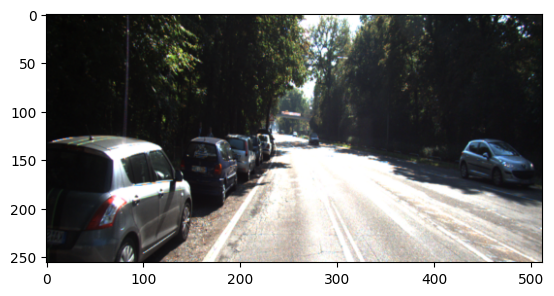

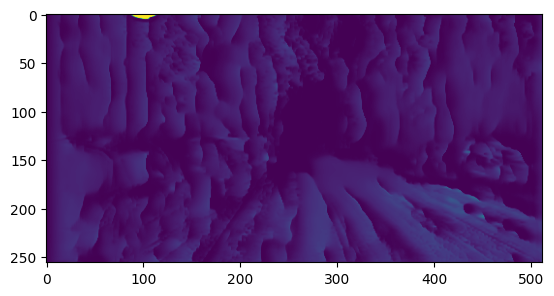

Epoch: 35 Train Loss: 1419.8024


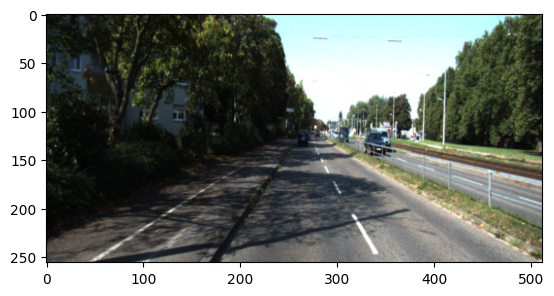

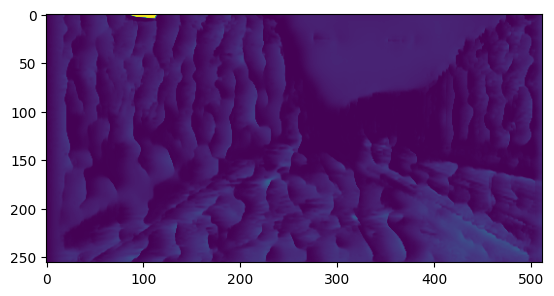

Epoch: 36 Train Loss: 1417.2251


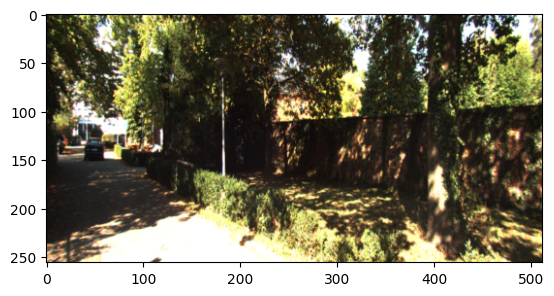

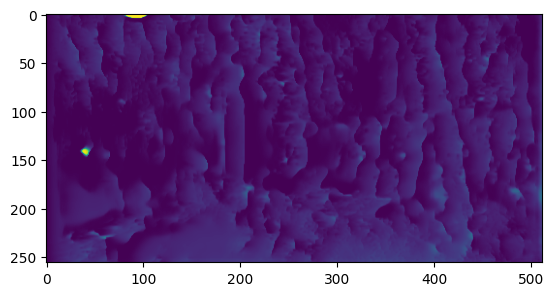

Epoch: 37 Train Loss: 1412.0099


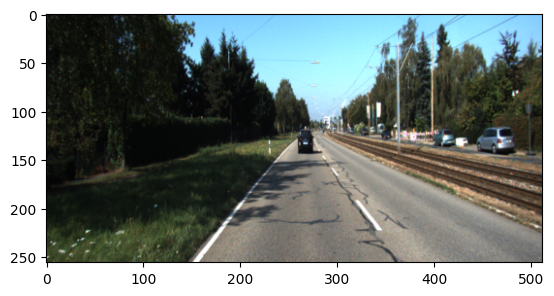

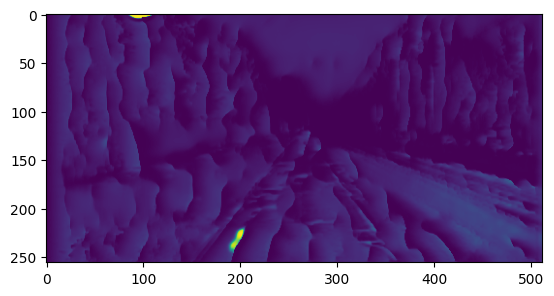

Epoch: 38 Train Loss: 1402.1276


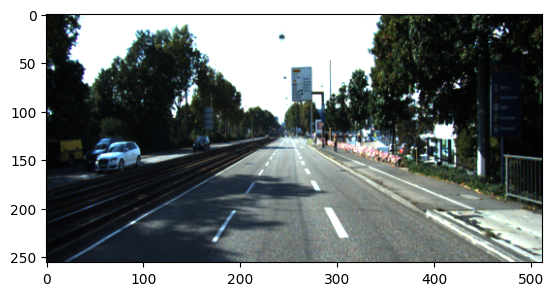

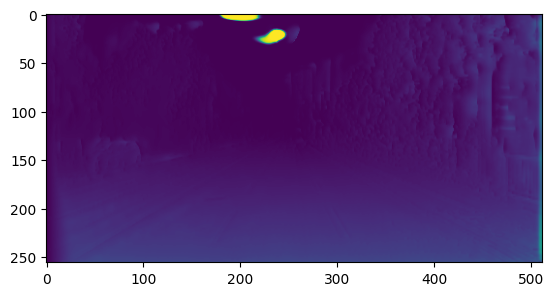

Epoch: 39 Train Loss: 1399.7104


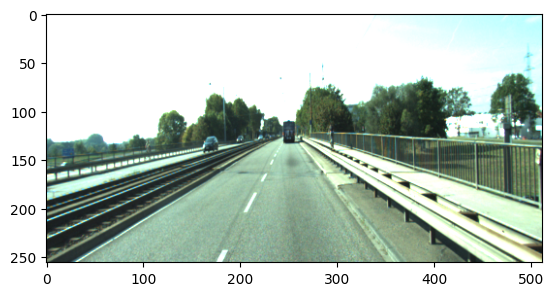

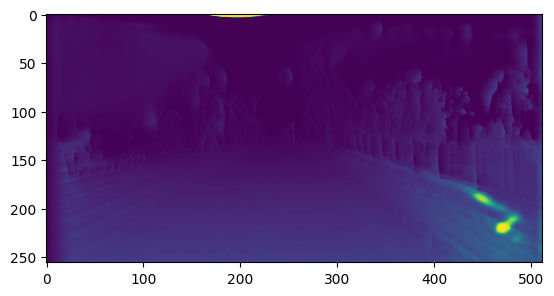

Epoch: 40 Train Loss: 1397.1959


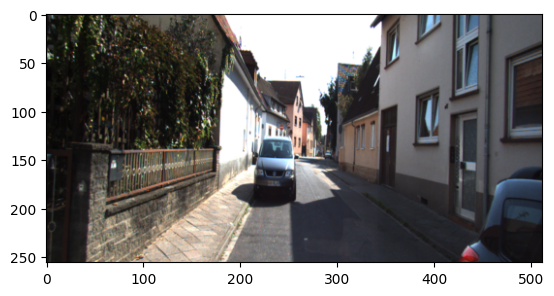

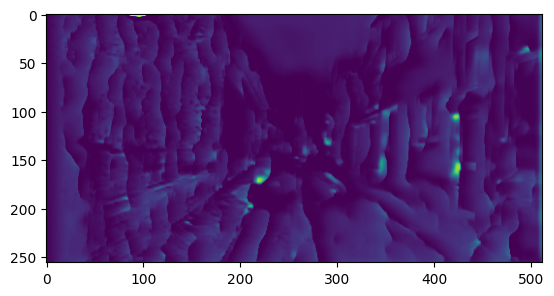

Epoch: 41 Train Loss: 1388.1761


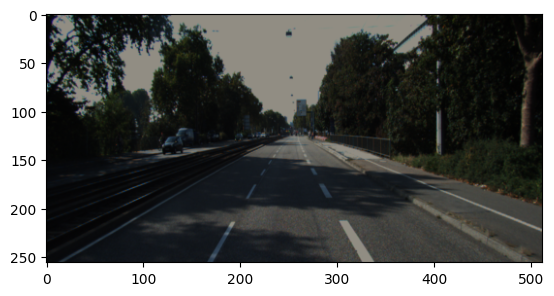

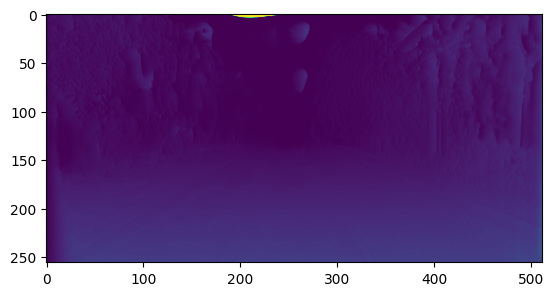

Epoch: 42 Train Loss: 1391.8279


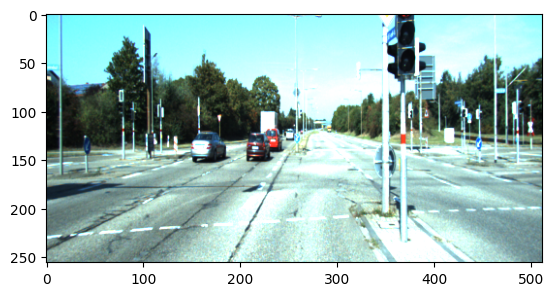

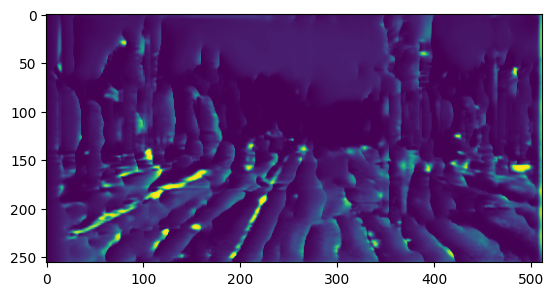

Epoch: 43 Train Loss: 1387.7824


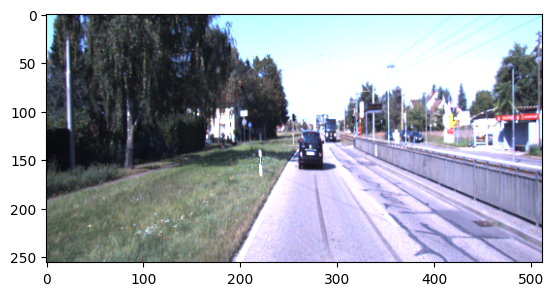

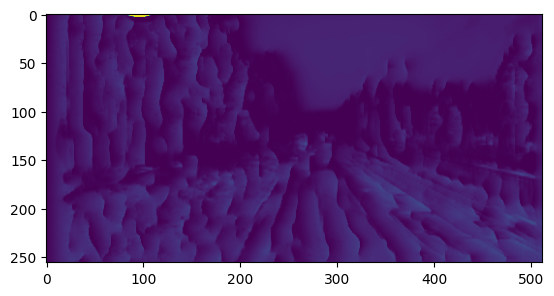

Epoch: 44 Train Loss: 1379.0207


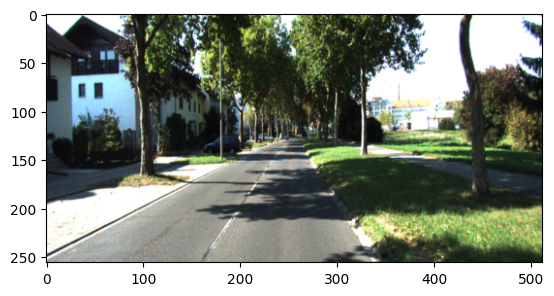

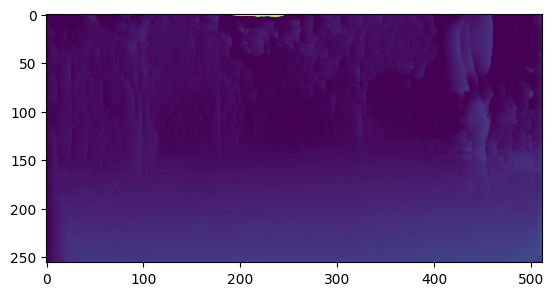

Epoch: 45 Train Loss: 1384.1211


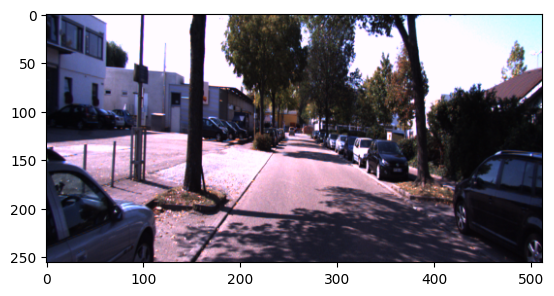

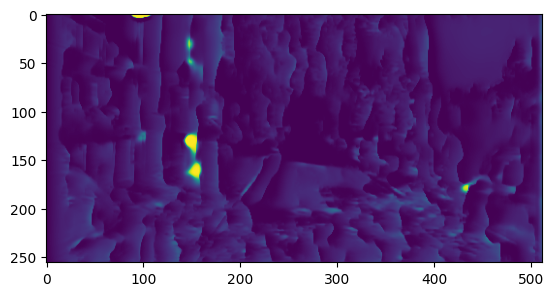

Epoch: 46 Train Loss: 1377.4801


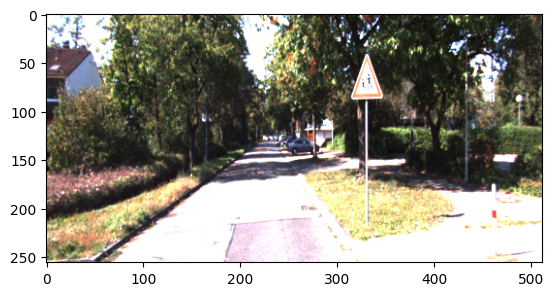

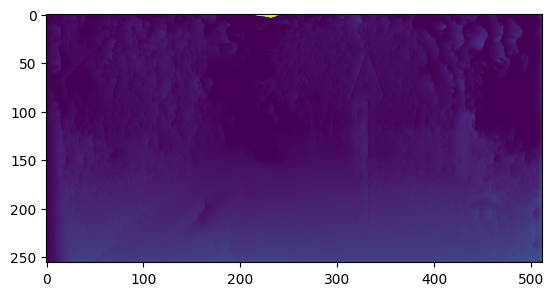

Epoch: 47 Train Loss: 1383.5438


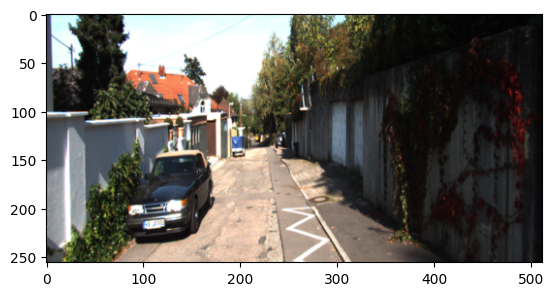

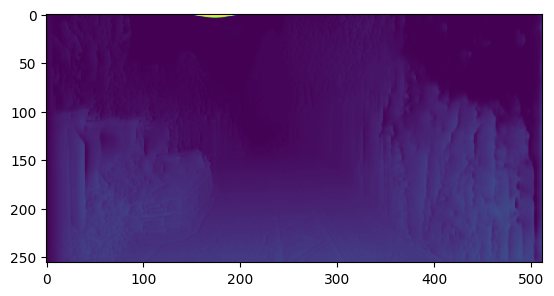

Epoch: 48 Train Loss: 1372.7281


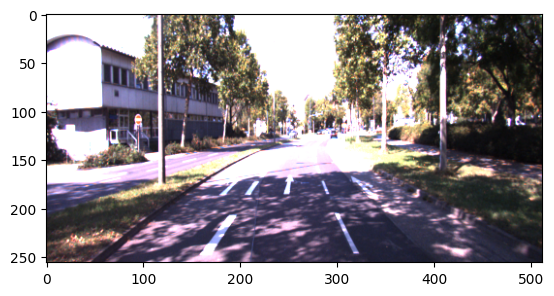

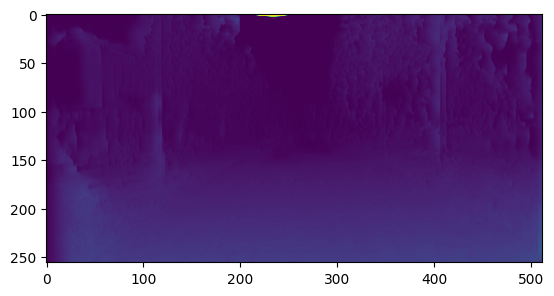

Epoch: 49 Train Loss: 1386.8762


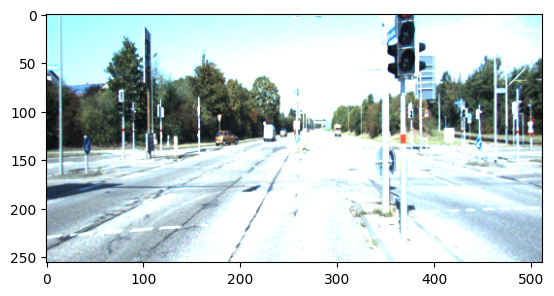

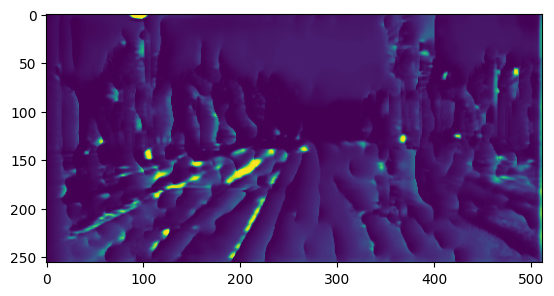

Saving model...
Model saved!


In [11]:
if __name__ == '__main__':
    in_channels = 3
    model = MonoDepthModel(
                model=Resnet50MonoDepth(in_channels),
                model_id='model_02',
                train_dir_left='../input/kitti-dataset/data_object_image_2/training',
                train_dir_right='../input/kitti-dataset/data_object_image_3/training',
                test_dir_left='../input/kitti-dataset/data_object_image_2/testing',
                test_dir_right='../input/kitti-dataset/data_object_image_3/testing',
                mode='train',
                test=False,
                lr=1e-3,
                control_lr=True,
                batch_size=8,
                max_epochs=50
    )
    model.train()
